In [1]:
import glob
import os
import numpy as np
import tensorflow as tf
import math as m
import random
from tensorflow import keras
from tensorflow.keras import layers
from keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array, array_to_img
from keras.models import Sequential, load_model
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras import backend as K
from keras import optimizers, regularizers
from keras.callbacks import ModelCheckpoint
from PIL import Image
import glob
import matplotlib.pyplot as plt

from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot

from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc


%matplotlib inline

Using TensorFlow backend.


### 1. Carga de imágenes

Se cargan los dos dataset de imágenes y se distribuyen aleatoriamente en grupos para training y test. El 80% de las imágenes se utilizará para training y el 20% restante para test.

In [2]:
A = []
for filename in glob.glob('Fotos Cobi/*.jpeg'):
    img = load_img(filename, target_size=(150, 150)) 
    A.append(img_to_array(img))
B = []
for filename in glob.glob('Fotos Gatos/*.jpg'):
    img = load_img(filename, target_size=(150, 150)) 
    B.append(img_to_array(img))

len_A_tr = m.floor(len(A)*0.8)
len_A_ts = m.floor(len(A)*0.2)
len_A_tr = len_A_tr + (len(A) - len_A_tr - len_A_ts)

len_B_tr = m.floor(len(B)*0.8)
len_B_ts = m.floor(len(B)*0.2)
len_B_tr = len_B_tr + (len(B) - len_B_tr - len_B_ts)

random.shuffle(A)
random.shuffle(B)

A_tr = []
B_tr = []
A_ts = []
B_ts = []
for i in range(0,len_A_tr):
    A_tr.append(A.pop(0))
for i in range(0,len_A_ts):
    A_ts.append(A.pop(0))
for i in range(0,len_B_tr):
    B_tr.append(B.pop(0))
for i in range(0,len_B_ts):
    B_ts.append(B.pop(0))

print(len(A_tr))
print(len(A_ts))
print(len(B_tr))
print(len(B_ts))

135
33
805
201


### 2. Data Augmentation

Realizamos data augmentation al dataset de fotos de Cobi ya que este tiene un número de imágenes mucho menor. Se busca el número de imágenes en las dos clases sea similiar.

In [3]:
for f in glob.glob('Fotos Cobi Augmentation (tr)/*.jpeg'):
    os.remove(f)
for f in glob.glob('Fotos Cobi Augmentation (ts)/*.jpeg'):
    os.remove(f)
    
datagen = ImageDataGenerator(
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        brightness_range = (0.5, 1.5))

for x in A_tr:
    x = x.reshape((1, ) + x.shape) 

    i = 0
    for batch in datagen.flow(x, batch_size = 1, 
                                save_to_dir ='Fotos Cobi Augmentation (tr)',  
                                save_prefix ='image', save_format ='jpeg'): 
        i += 1
        if i > 5: 
            break
            
for x in A_ts:
    x = x.reshape((1, ) + x.shape) 

    i = 0
    for batch in datagen.flow(x, batch_size = 1, 
                                save_to_dir ='Fotos Cobi Augmentation (ts)',  
                                save_prefix ='image', save_format ='jpeg'): 
        i += 1
        if i > 5: 
            break


A_tr = []
for filename in glob.glob('Fotos Cobi Augmentation (tr)/*.jpeg'):
    img = load_img(filename, target_size=(150, 150)) 
    A_tr.append(img_to_array(img))
    
A_ts = []
for filename in glob.glob('Fotos Cobi Augmentation (ts)/*.jpeg'):
    img = load_img(filename, target_size=(150, 150)) 
    A_ts.append(img_to_array(img))
    
print(len(A_tr))
print(len(A_ts))

768
195


### 4. Preparación input del modelo

Se guardan las imágenes (tanto para training como para test) en un array X y se creá un array Y que contiene la clase correspondiente. Está sera la entrada para nuestro modelo

In [4]:
X_tr = []
Y_tr = []
X_ts = []
Y_ts = []

X_tr = A_tr + B_tr
X_ts = A_ts + B_ts

for i in range(0,len(A_tr)):
    Y_tr.append(0)
for i in range(len(A_tr), len(B_tr) + len(A_tr)):
    Y_tr.append(1)
for i in range(0,len(A_ts)):
    Y_ts.append(0)
for i in range(len(A_ts), len(B_ts) + len(A_ts)):
    Y_ts.append(1)
      
X_tr = np.array(X_tr)
Y_tr = np.array(Y_tr)
X_ts = np.array(X_ts)
Y_ts = np.array(Y_ts)

### 5. Definición del modelo

Se define el modelo que se va a utilizar y el lugar donde se guardará los distintos checkpoints

In [5]:
img_width, img_height = 150, 150
input_shape = (img_width, img_height, 3)

model = tf.keras.Sequential()
model.add(layers.Conv2D(32, (3,3), activation='relu',
                 input_shape=input_shape))
model.add(layers.MaxPooling2D((2,2)))
model.add(layers.Conv2D(64, (3,3), activation='relu'))
model.add(layers.MaxPooling2D((2,2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy',
              optimizer=tf.keras.optimizers.RMSprop(),
              metrics=['acc'])

cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath="trained_model/cp.ckpt",
                                                 save_weights_only=True,
                                                 verbose=1)

In [6]:
acum_tr_acc = []
acum_val_acc = []
batch_size = 16

### 6. Fase de entrenamiento

In [7]:
model.fit(X_tr, Y_tr,
    batch_size=batch_size,
    epochs=100,
    validation_data=(X_ts, Y_ts),
    callbacks=[cp_callback])


Train on 1573 samples, validate on 396 samples
Epoch 1/100
1568/1573 [============================>.] - ETA: 0s - loss: 33.3448 - acc: 0.5886
Epoch 00001: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 30s 19ms/sample - loss: 33.2408 - acc: 0.5887 - val_loss: 0.6405 - val_acc: 0.6237
Epoch 2/100
1568/1573 [============================>.] - ETA: 0s - loss: 1.8818 - acc: 0.6614
Epoch 00002: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 28s 18ms/sample - loss: 1.8774 - acc: 0.6612 - val_loss: 0.6038 - val_acc: 0.6692
Epoch 3/100
1568/1573 [============================>.] - ETA: 0s - loss: 1.3384 - acc: 0.7245
Epoch 00003: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 29s 19ms/sample - loss: 1.3365 - acc: 0.7247 - val_loss: 0.9636 - val_acc: 0.7222
Epoch 4/100
1568/1573 [============================>.] - ETA: 0s - loss: 1.8317 - acc: 0.7423
Epoch 00004: saving model to trained_mode

Epoch 31/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.7558 - acc: 0.9222
Epoch 00031: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.7534 - acc: 0.9224 - val_loss: 2.9423 - val_acc: 0.7955
Epoch 32/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.4343 - acc: 0.9681
Epoch 00032: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.4329 - acc: 0.9682 - val_loss: 4.3211 - val_acc: 0.8056
Epoch 33/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.5986 - acc: 0.9605
Epoch 00033: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 28s 18ms/sample - loss: 0.5967 - acc: 0.9606 - val_loss: 7.7544 - val_acc: 0.8056
Epoch 34/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.2262 - acc: 0.9764
Epoch 00034: saving model to trained_model/cp.ckpt
1573/1573 [========================

1568/1573 [============================>.] - ETA: 0s - loss: 0.1932 - acc: 0.9853
Epoch 00061: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.1926 - acc: 0.9854 - val_loss: 5.2382 - val_acc: 0.8434
Epoch 62/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.3123 - acc: 0.9847
Epoch 00062: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.3113 - acc: 0.9847 - val_loss: 10.1080 - val_acc: 0.7677
Epoch 63/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.2519 - acc: 0.9872
Epoch 00063: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.2511 - acc: 0.9873 - val_loss: 5.3410 - val_acc: 0.7980
Epoch 64/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.2713 - acc: 0.9777
Epoch 00064: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 28

1568/1573 [============================>.] - ETA: 0s - loss: 0.4247 - acc: 0.9853
Epoch 00091: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.4233 - acc: 0.9854 - val_loss: 6.9295 - val_acc: 0.8005
Epoch 92/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.1125 - acc: 0.9936
Epoch 00092: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.1122 - acc: 0.9936 - val_loss: 10.7250 - val_acc: 0.8030
Epoch 93/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.2898 - acc: 0.9898
Epoch 00093: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27s 17ms/sample - loss: 0.2889 - acc: 0.9898 - val_loss: 8.5368 - val_acc: 0.7929
Epoch 94/100
1568/1573 [============================>.] - ETA: 0s - loss: 0.2470 - acc: 0.9892
Epoch 00094: saving model to trained_model/cp.ckpt
1573/1573 [==============================] - 27

### 7. Prueba del modelo y conclusiones

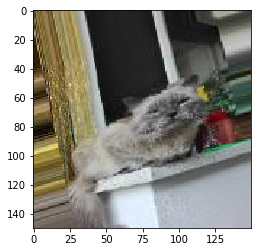

Es Cobi


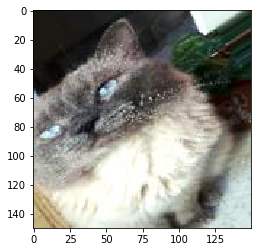

Es Cobi


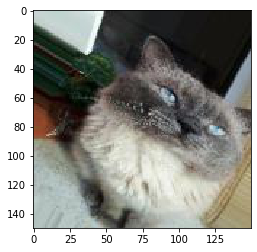

Es Cobi


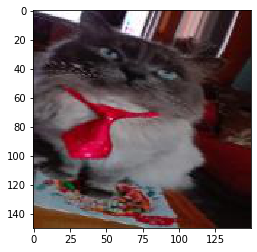

No es Cobi


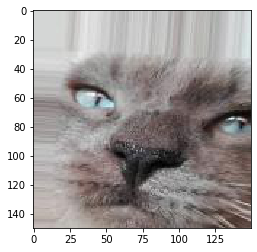

Es Cobi


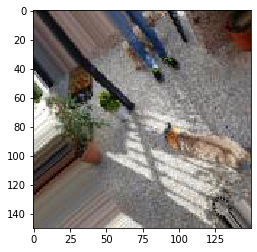

Es Cobi


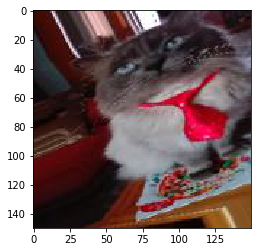

Es Cobi


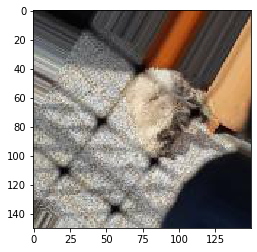

Es Cobi


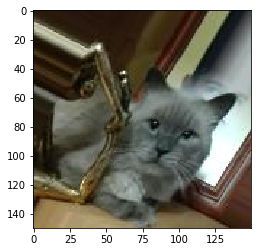

Es Cobi


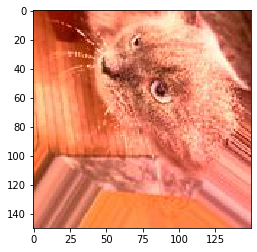

Es Cobi


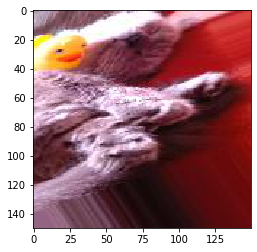

No es Cobi


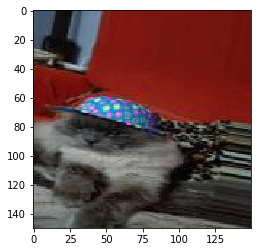

Es Cobi


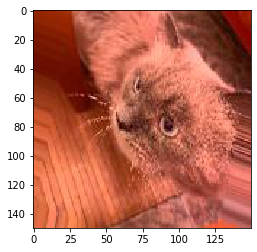

Es Cobi


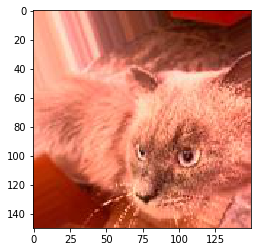

Es Cobi


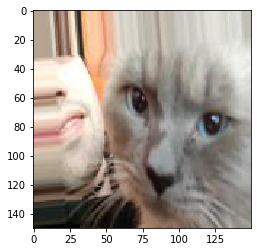

Es Cobi


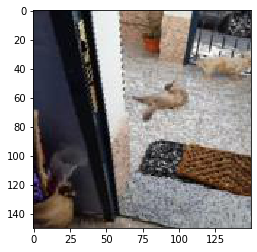

No es Cobi


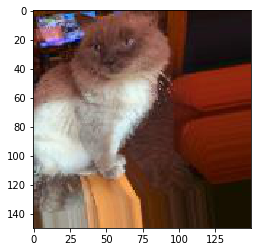

Es Cobi


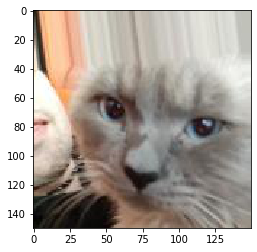

Es Cobi


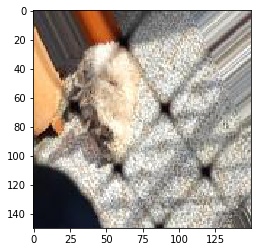

Es Cobi


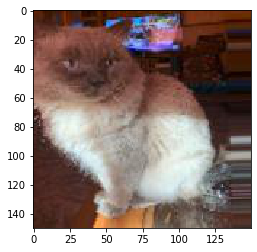

Es Cobi


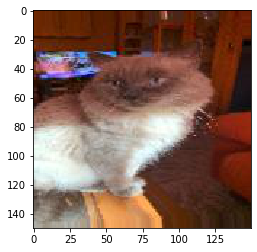

Es Cobi


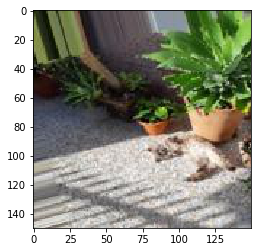

No es Cobi


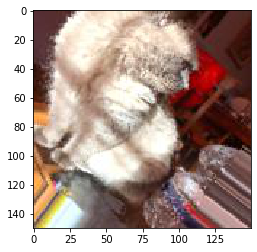

Es Cobi


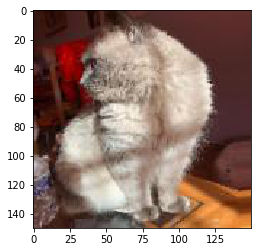

No es Cobi


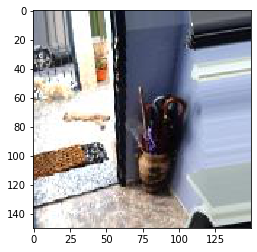

No es Cobi


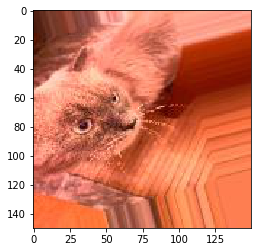

Es Cobi


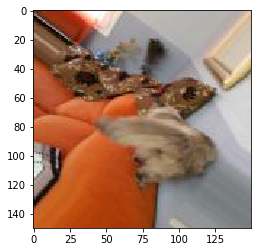

Es Cobi


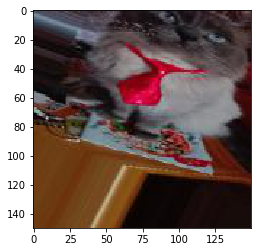

Es Cobi


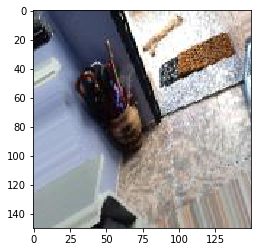

No es Cobi


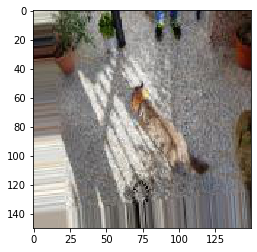

Es Cobi


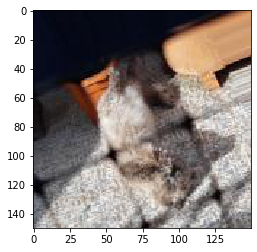

Es Cobi


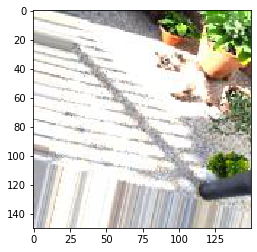

Es Cobi


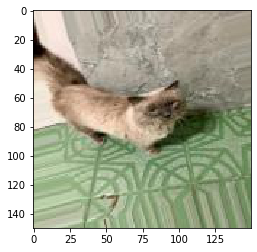

Es Cobi


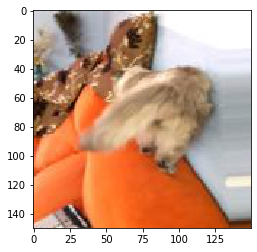

Es Cobi


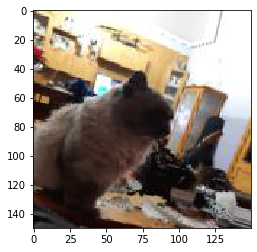

No es Cobi


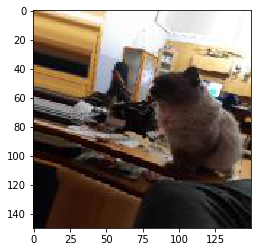

Es Cobi


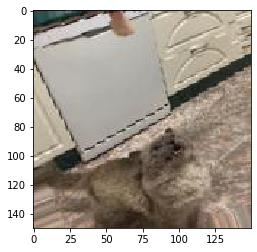

No es Cobi


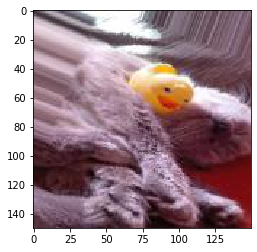

Es Cobi


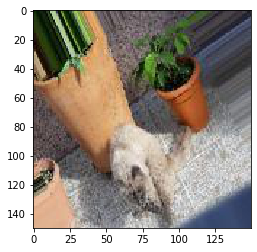

Es Cobi


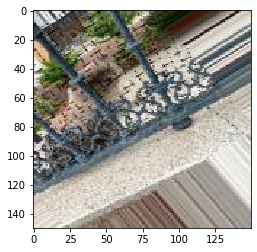

Es Cobi


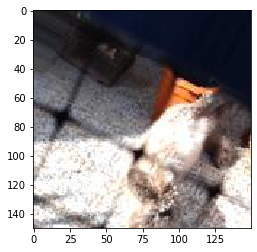

No es Cobi


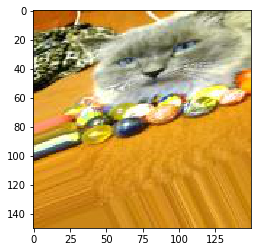

Es Cobi


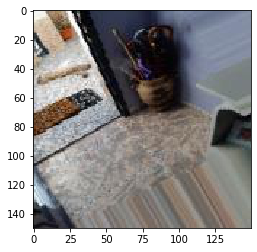

Es Cobi


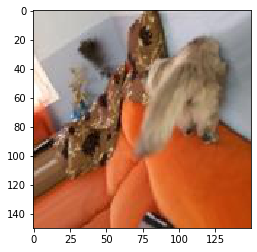

Es Cobi


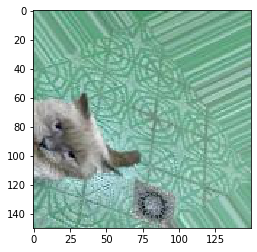

Es Cobi


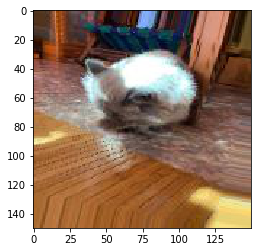

Es Cobi


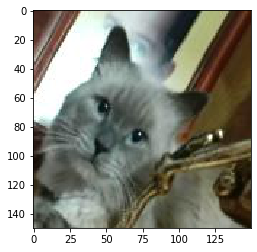

Es Cobi


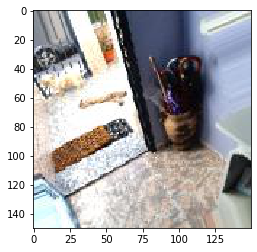

No es Cobi


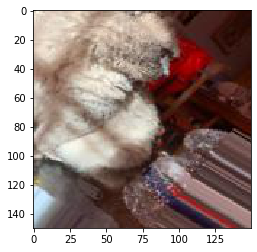

Es Cobi


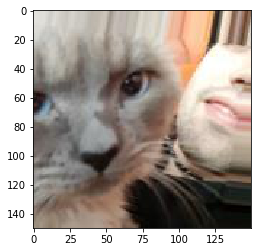

Es Cobi


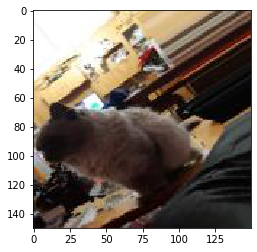

Es Cobi


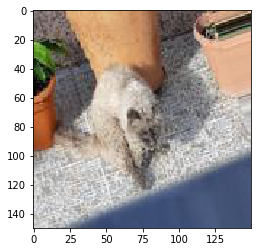

Es Cobi


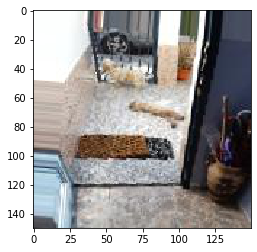

Es Cobi


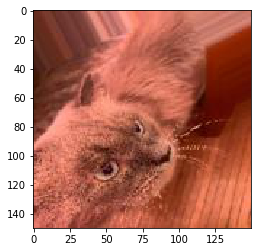

Es Cobi


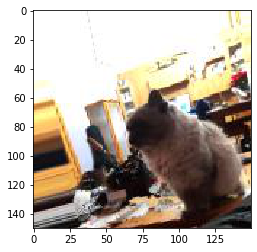

Es Cobi


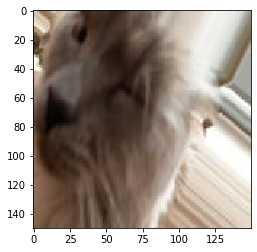

Es Cobi


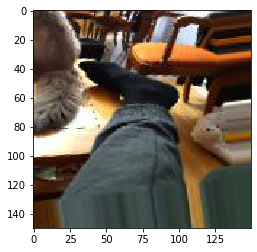

Es Cobi


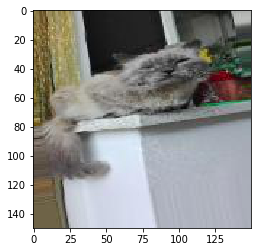

Es Cobi


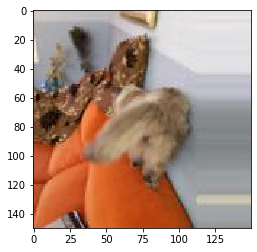

Es Cobi


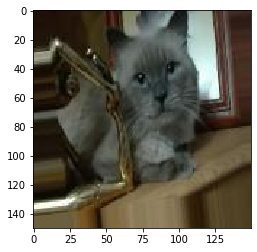

Es Cobi


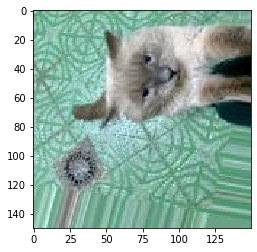

Es Cobi


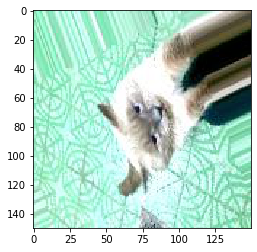

Es Cobi


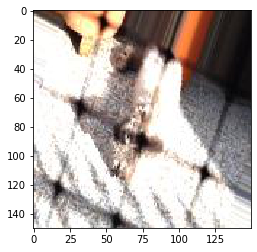

No es Cobi


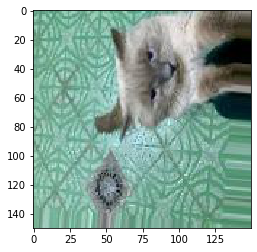

Es Cobi


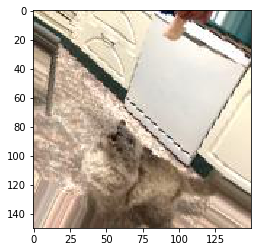

Es Cobi


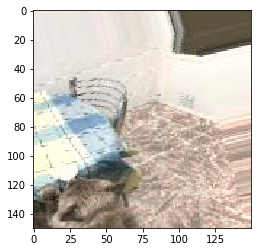

Es Cobi


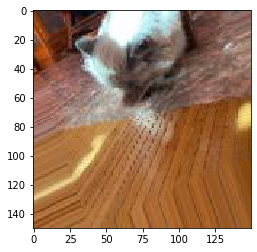

Es Cobi


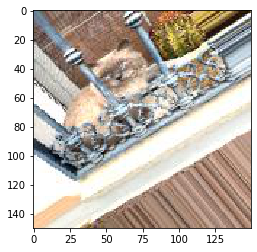

Es Cobi


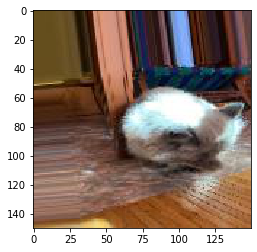

Es Cobi


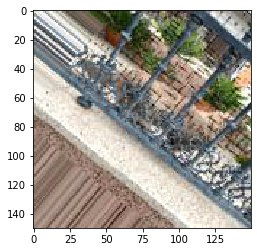

Es Cobi


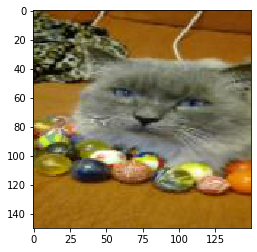

Es Cobi


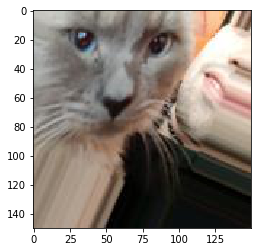

Es Cobi


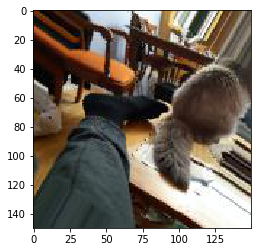

Es Cobi


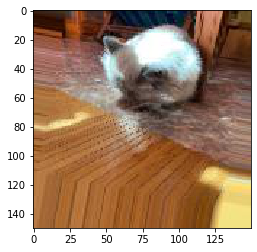

Es Cobi


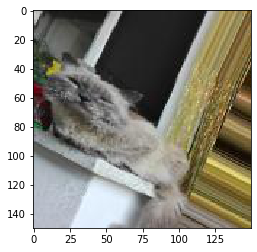

Es Cobi


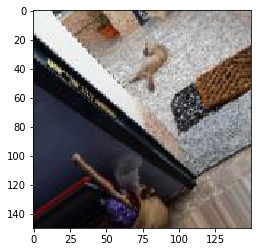

Es Cobi


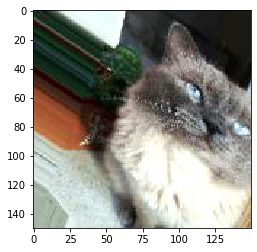

Es Cobi


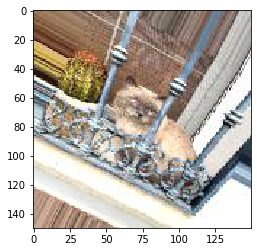

Es Cobi


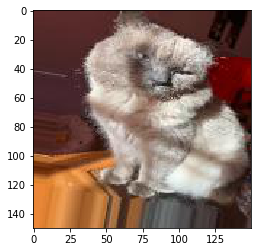

Es Cobi


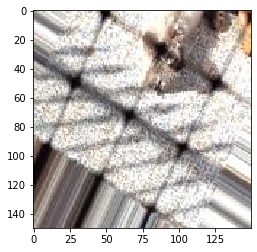

Es Cobi


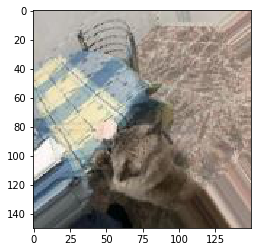

Es Cobi


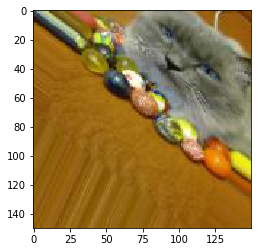

Es Cobi


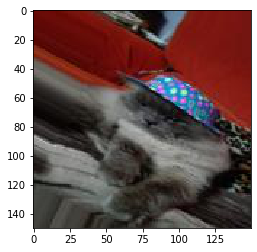

Es Cobi


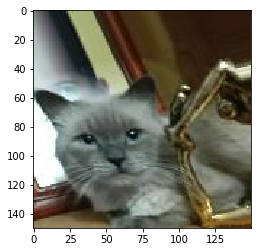

Es Cobi


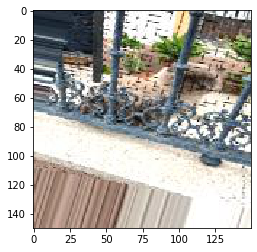

Es Cobi


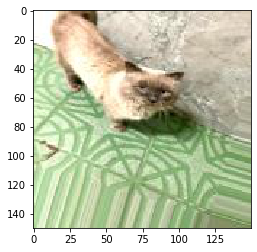

Es Cobi


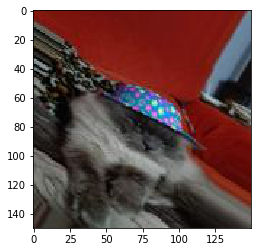

Es Cobi


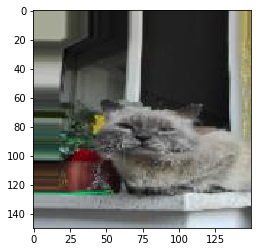

No es Cobi


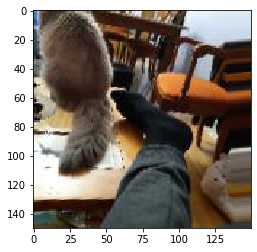

Es Cobi


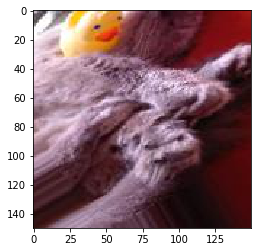

Es Cobi


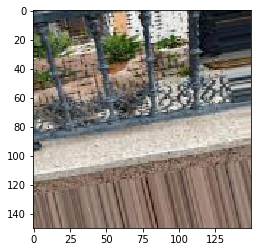

Es Cobi


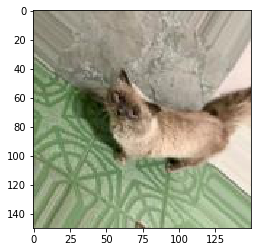

Es Cobi


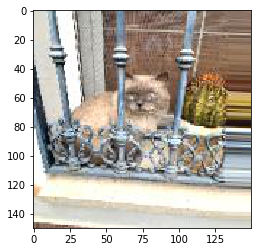

Es Cobi


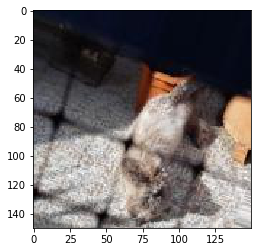

Es Cobi


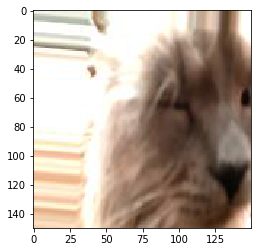

No es Cobi


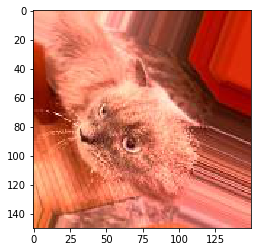

Es Cobi


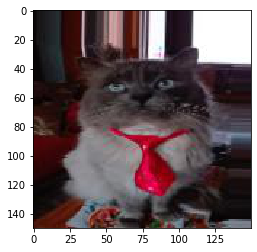

No es Cobi


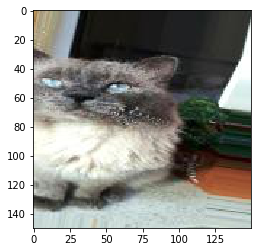

Es Cobi


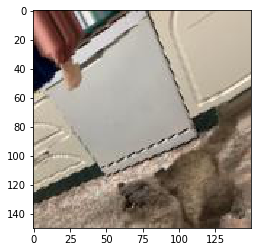

Es Cobi


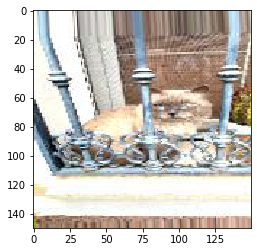

Es Cobi


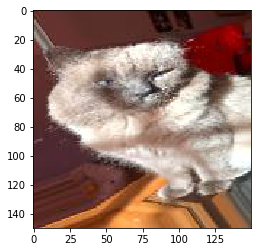

Es Cobi


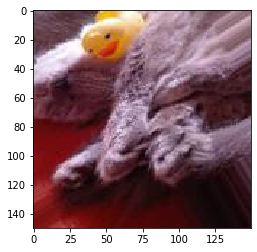

Es Cobi


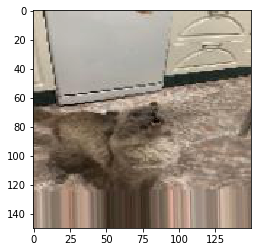

Es Cobi


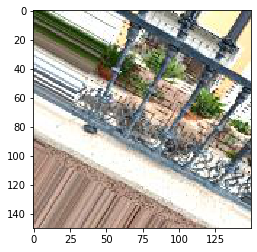

Es Cobi


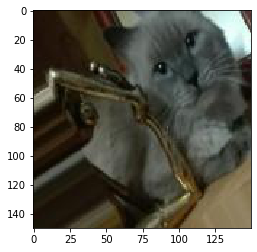

Es Cobi


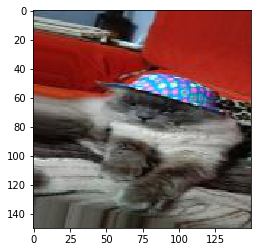

No es Cobi


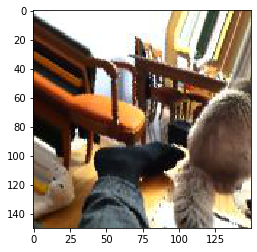

No es Cobi


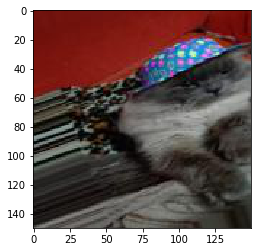

Es Cobi


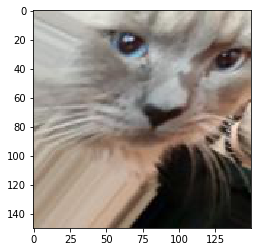

Es Cobi


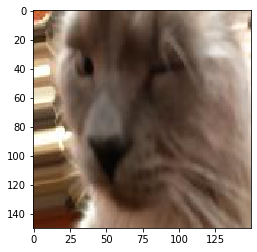

Es Cobi


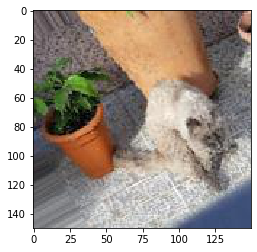

Es Cobi


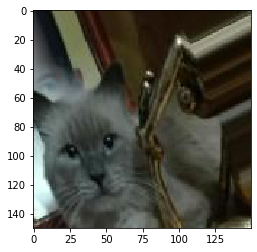

Es Cobi


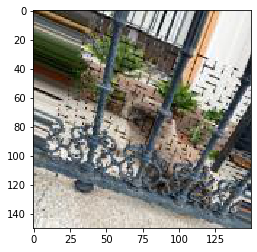

No es Cobi


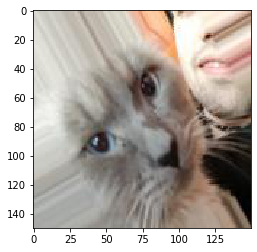

Es Cobi


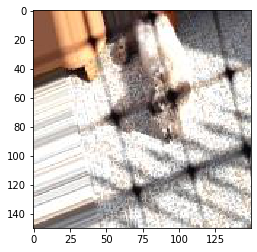

Es Cobi


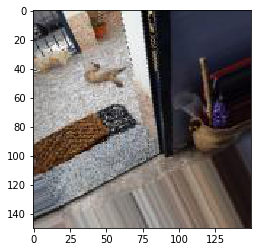

No es Cobi


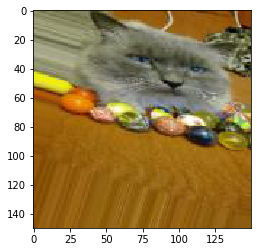

Es Cobi


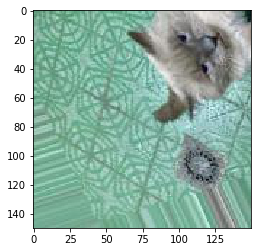

No es Cobi


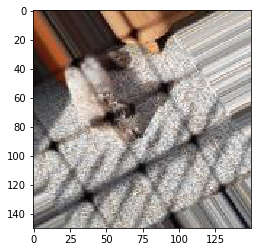

No es Cobi


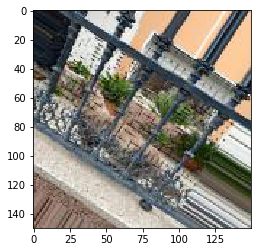

Es Cobi


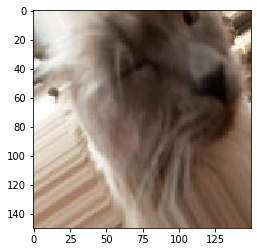

Es Cobi


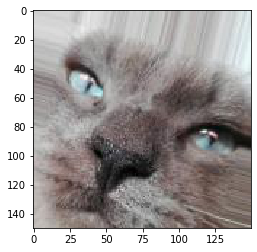

Es Cobi


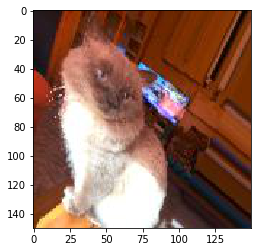

Es Cobi


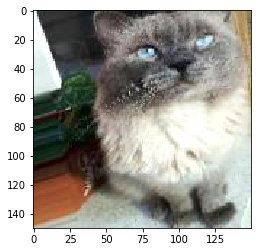

Es Cobi


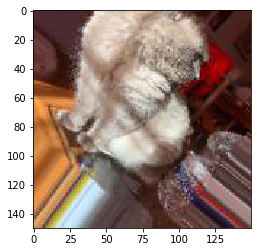

Es Cobi


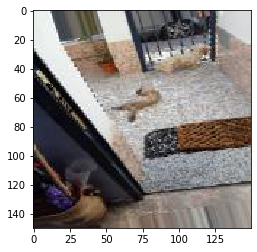

Es Cobi


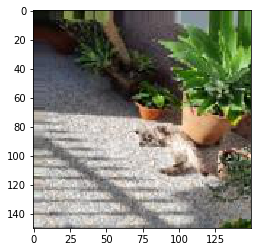

Es Cobi


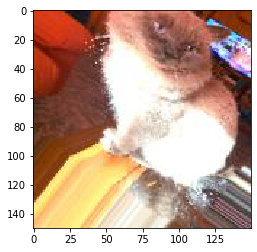

No es Cobi


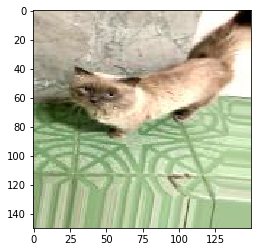

Es Cobi


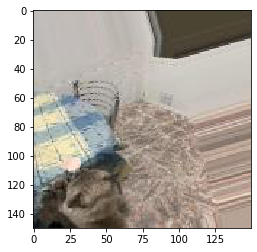

Es Cobi


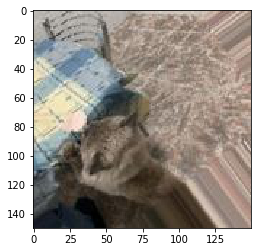

Es Cobi


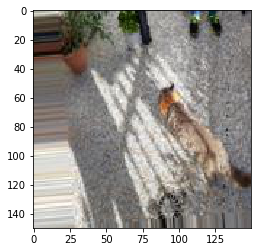

Es Cobi


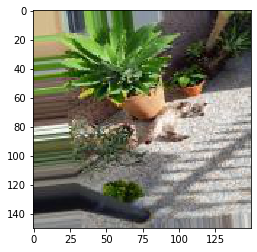

No es Cobi


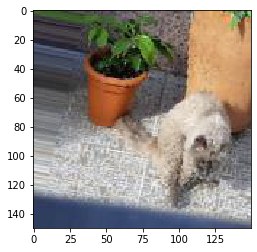

No es Cobi


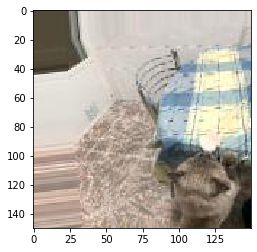

No es Cobi


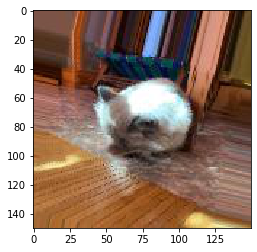

Es Cobi


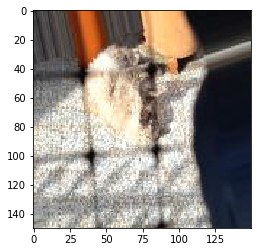

No es Cobi


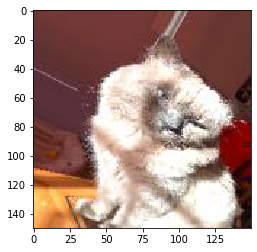

Es Cobi


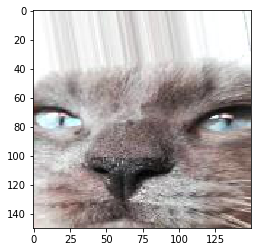

Es Cobi


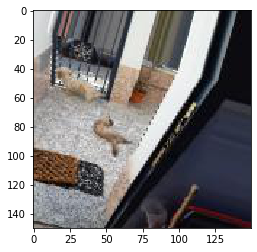

Es Cobi


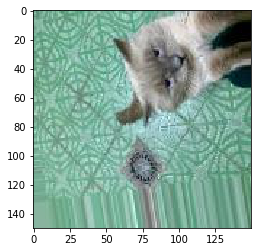

Es Cobi


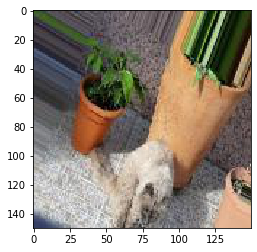

Es Cobi


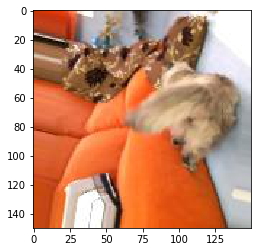

Es Cobi


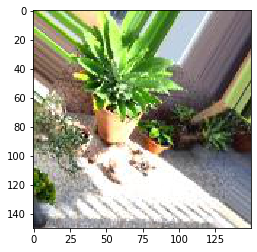

Es Cobi


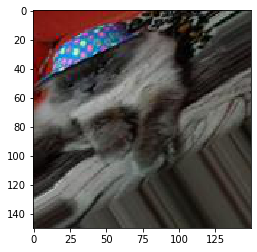

Es Cobi


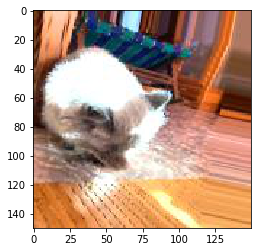

Es Cobi


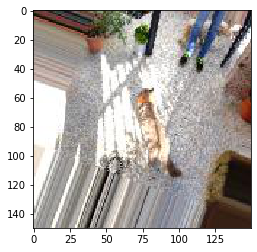

Es Cobi


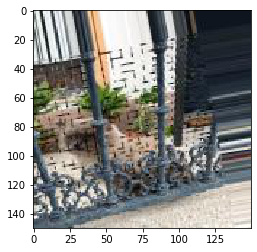

Es Cobi


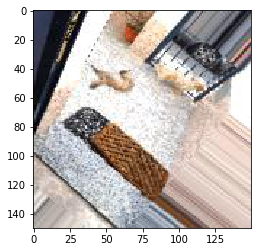

No es Cobi


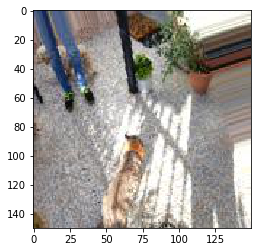

Es Cobi


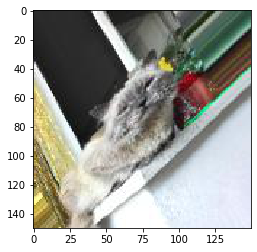

No es Cobi


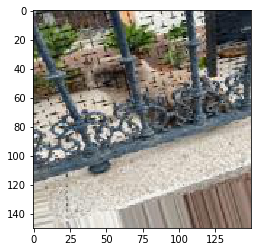

Es Cobi


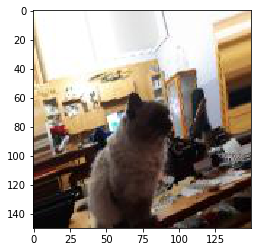

No es Cobi


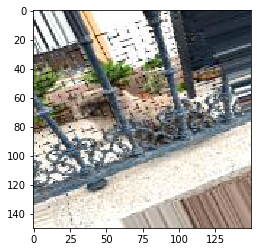

Es Cobi


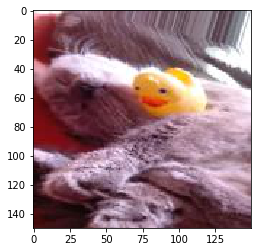

Es Cobi


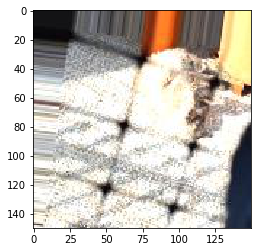

No es Cobi


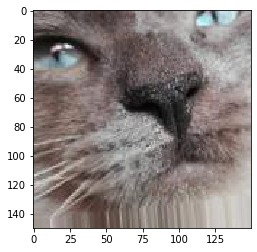

Es Cobi


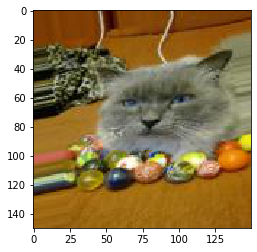

Es Cobi


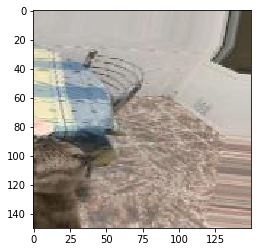

Es Cobi


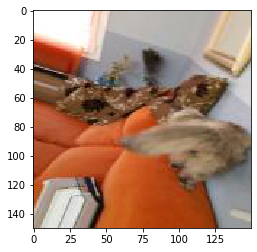

Es Cobi


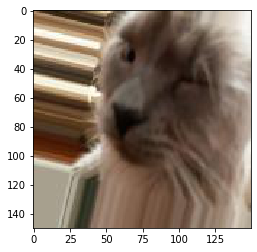

Es Cobi


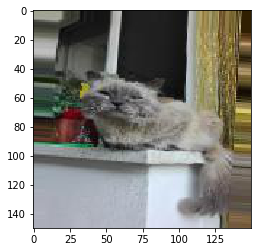

Es Cobi


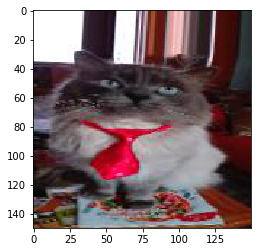

Es Cobi


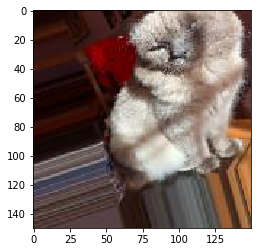

No es Cobi


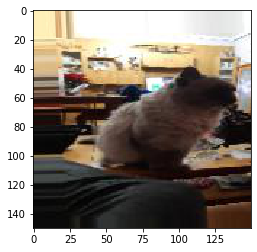

Es Cobi


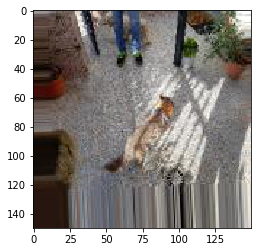

Es Cobi


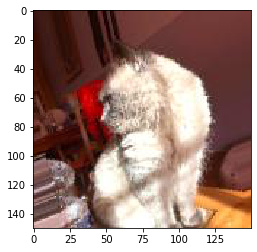

Es Cobi


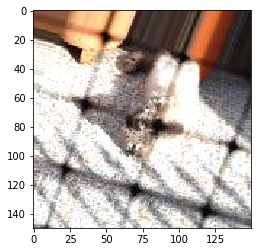

Es Cobi


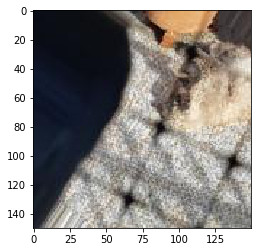

No es Cobi


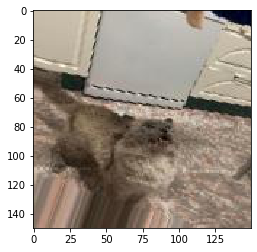

Es Cobi


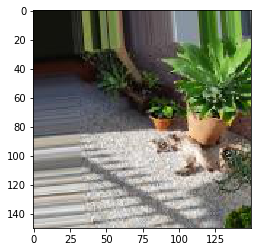

Es Cobi


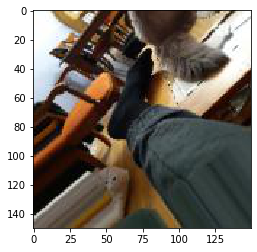

Es Cobi


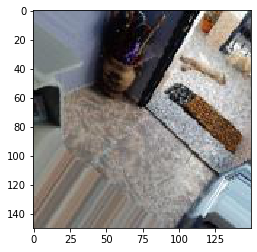

Es Cobi


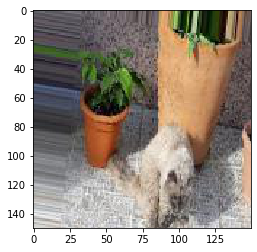

Es Cobi


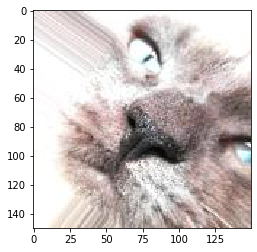

No es Cobi


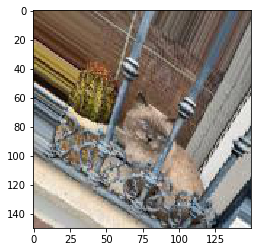

Es Cobi


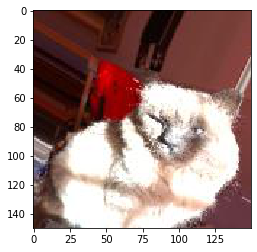

Es Cobi


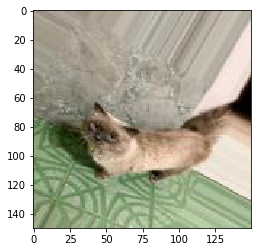

Es Cobi


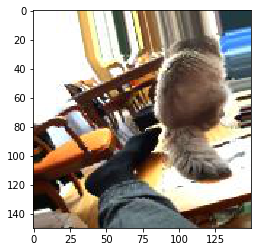

Es Cobi


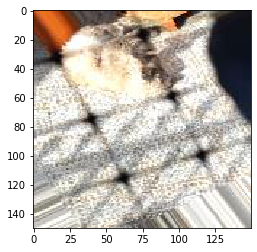

Es Cobi


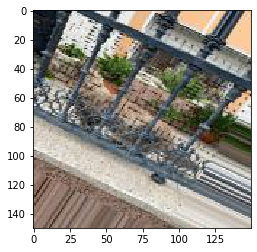

Es Cobi


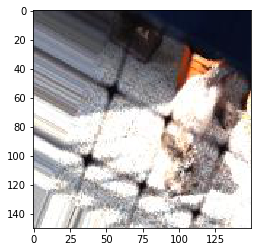

Es Cobi


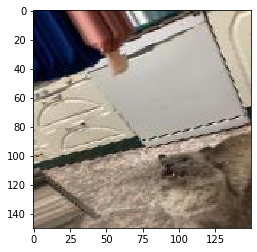

Es Cobi


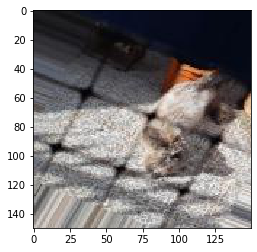

No es Cobi


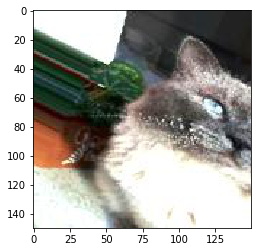

Es Cobi


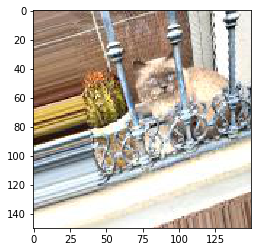

Es Cobi


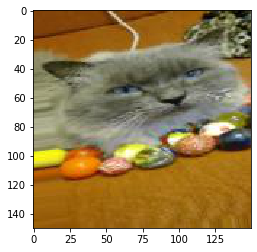

Es Cobi


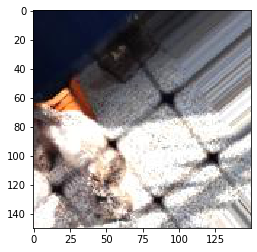

Es Cobi


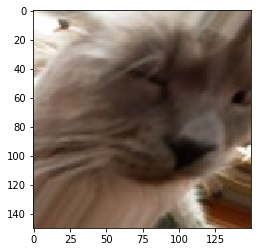

Es Cobi


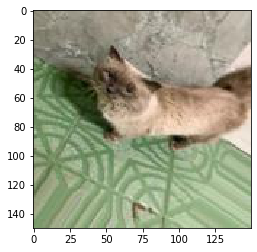

Es Cobi


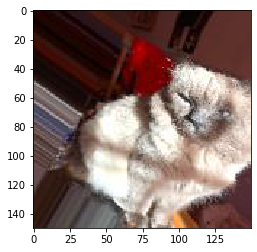

Es Cobi


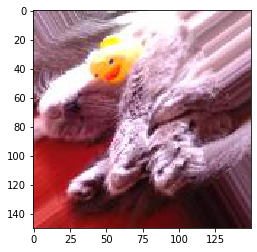

Es Cobi


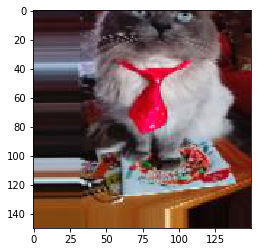

Es Cobi


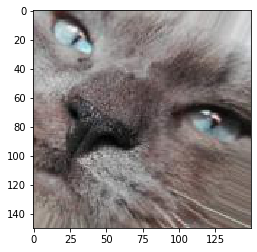

Es Cobi


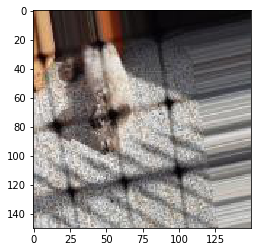

Es Cobi


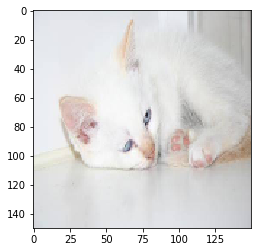

No es Cobi


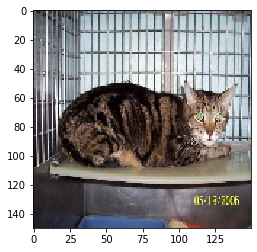

No es Cobi


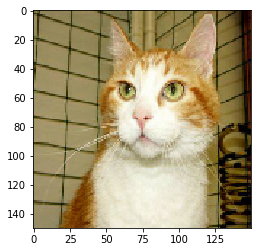

Es Cobi


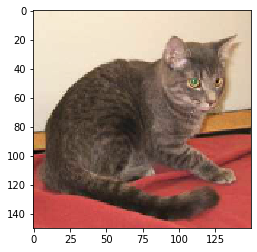

No es Cobi


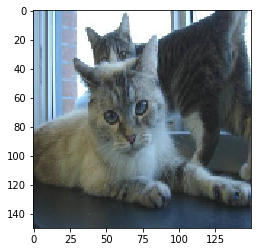

No es Cobi


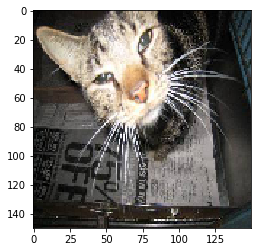

No es Cobi


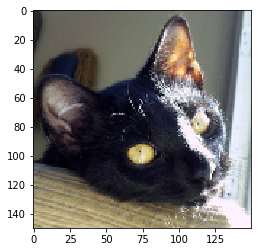

No es Cobi


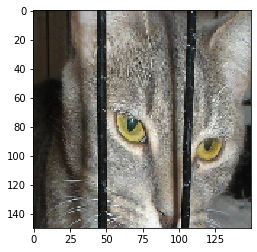

No es Cobi


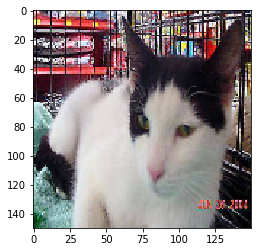

No es Cobi


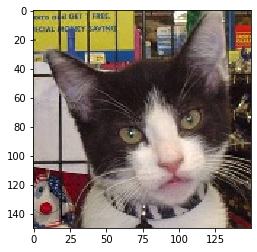

Es Cobi


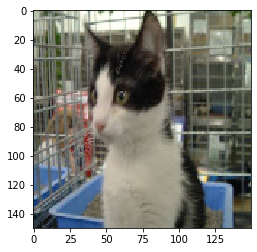

No es Cobi


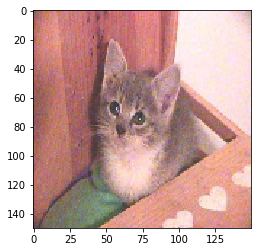

No es Cobi


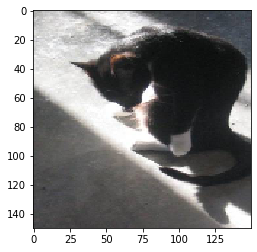

No es Cobi


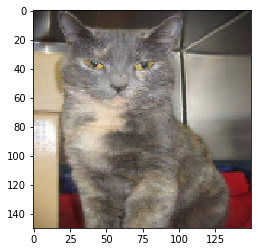

Es Cobi


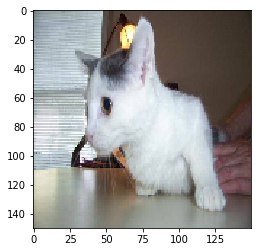

Es Cobi


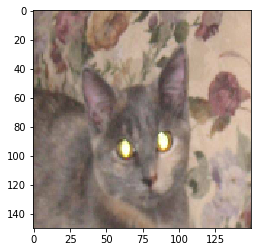

No es Cobi


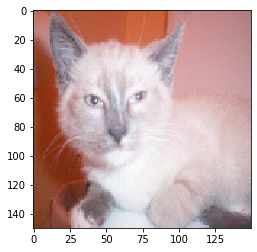

Es Cobi


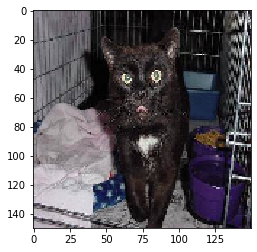

No es Cobi


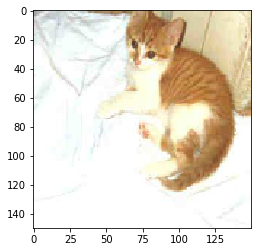

No es Cobi


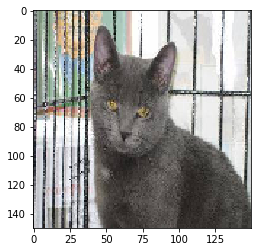

No es Cobi


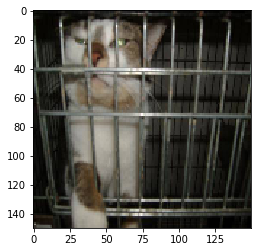

No es Cobi


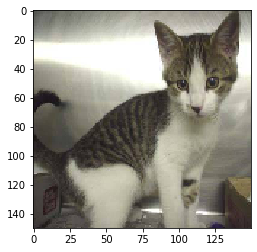

Es Cobi


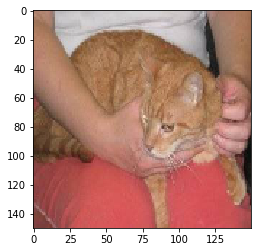

No es Cobi


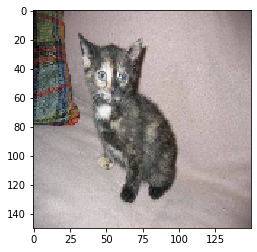

No es Cobi


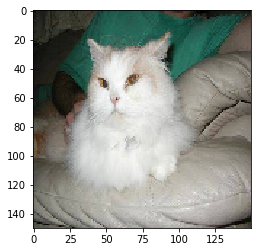

No es Cobi


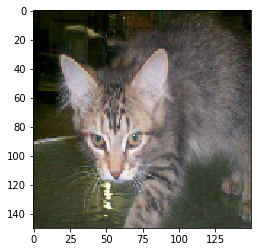

Es Cobi


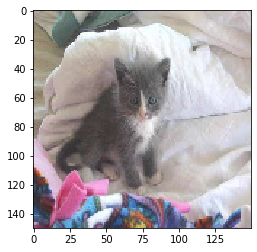

No es Cobi


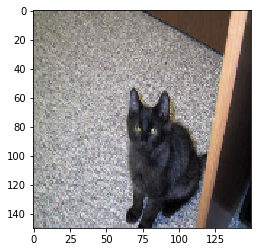

No es Cobi


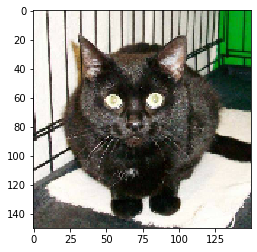

No es Cobi


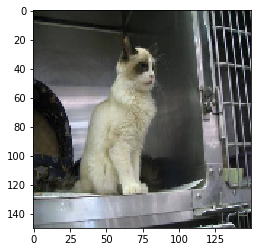

No es Cobi


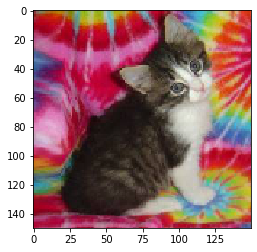

No es Cobi


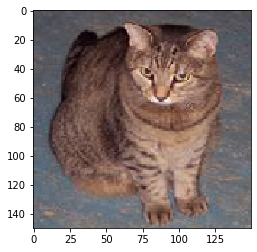

No es Cobi


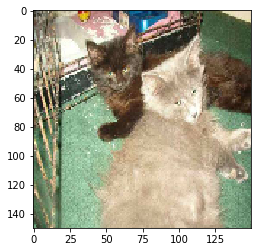

No es Cobi


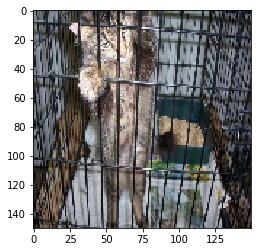

No es Cobi


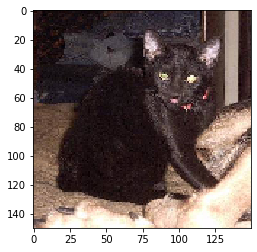

No es Cobi


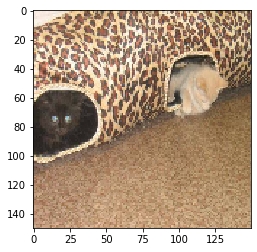

No es Cobi


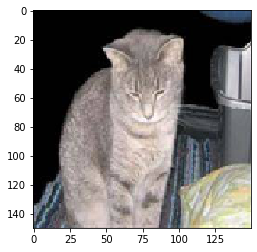

Es Cobi


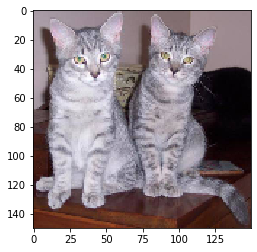

Es Cobi


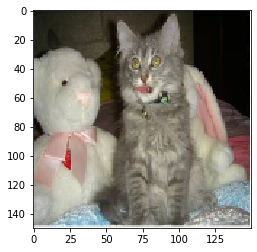

No es Cobi


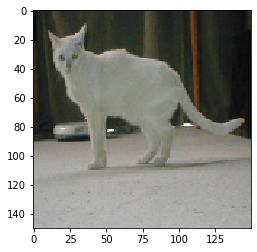

Es Cobi


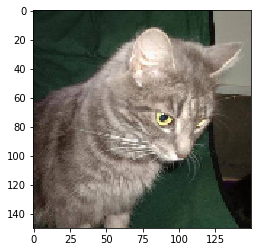

Es Cobi


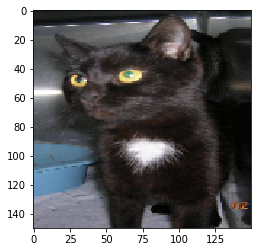

No es Cobi


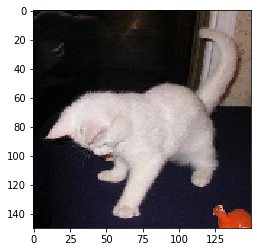

Es Cobi


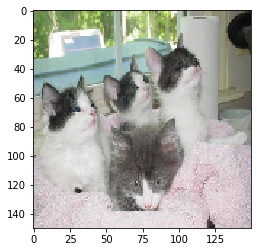

Es Cobi


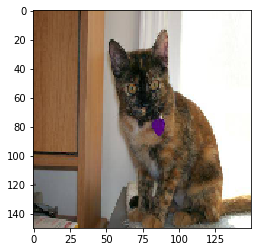

No es Cobi


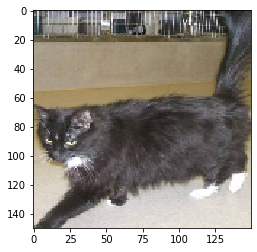

Es Cobi


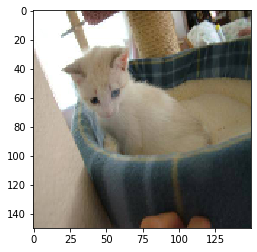

No es Cobi


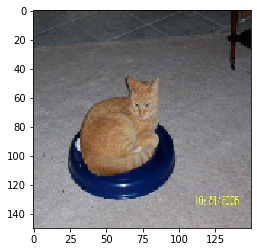

No es Cobi


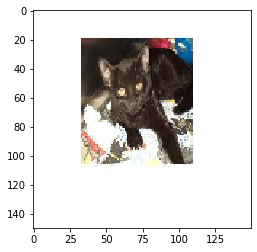

No es Cobi


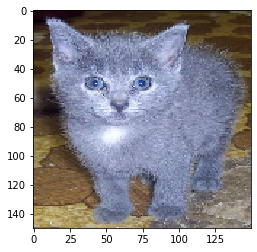

No es Cobi


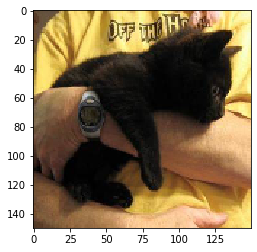

No es Cobi


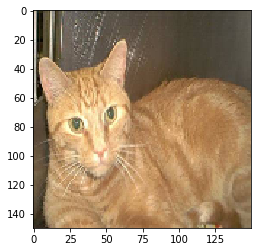

No es Cobi


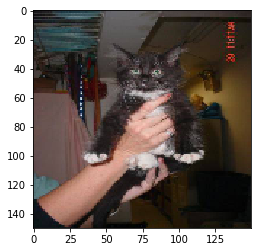

No es Cobi


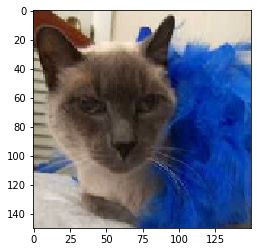

No es Cobi


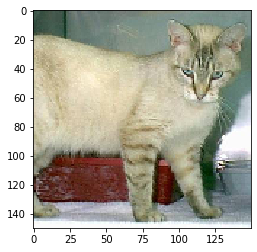

No es Cobi


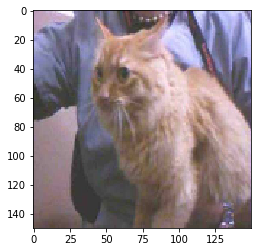

No es Cobi


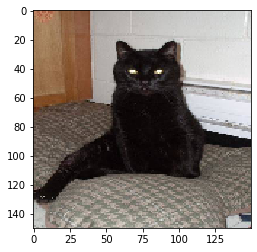

Es Cobi


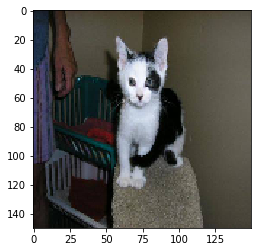

No es Cobi


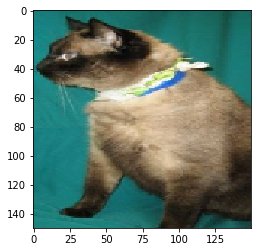

No es Cobi


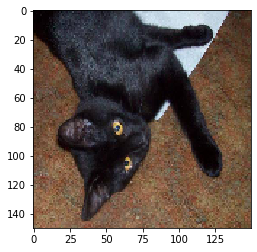

No es Cobi


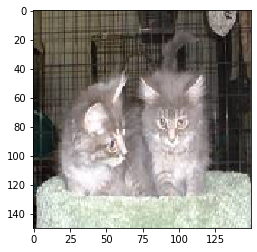

No es Cobi


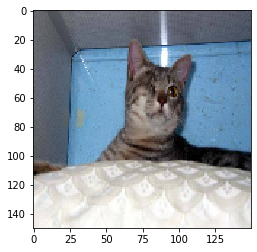

No es Cobi


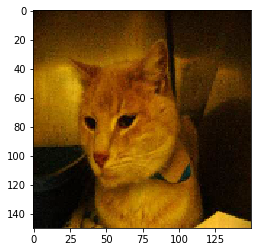

No es Cobi


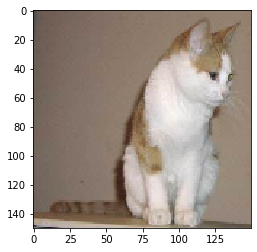

Es Cobi


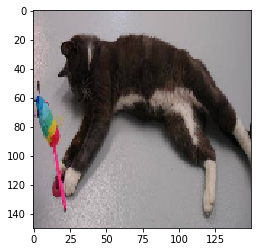

No es Cobi


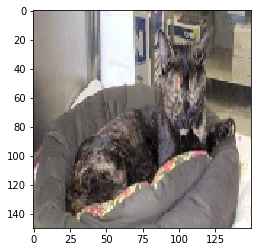

No es Cobi


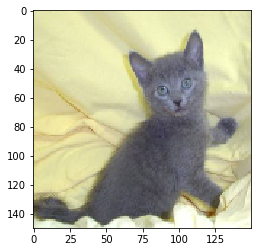

No es Cobi


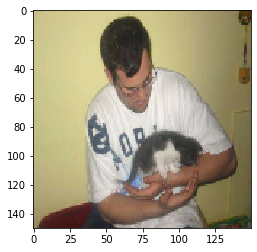

Es Cobi


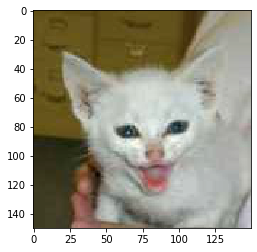

Es Cobi


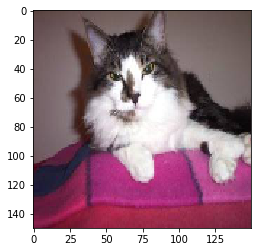

No es Cobi


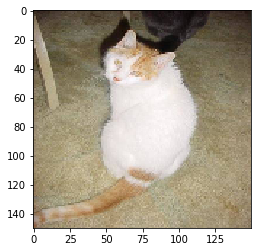

No es Cobi


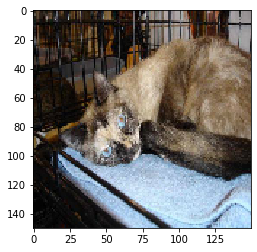

No es Cobi


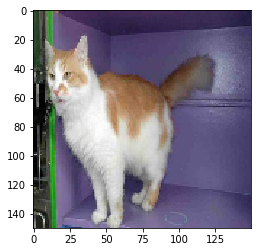

No es Cobi


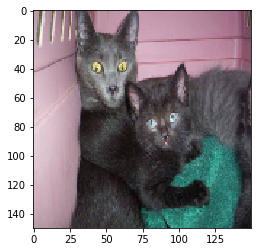

No es Cobi


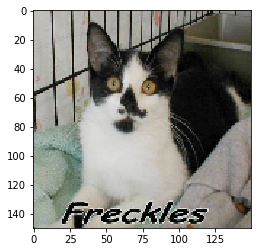

No es Cobi


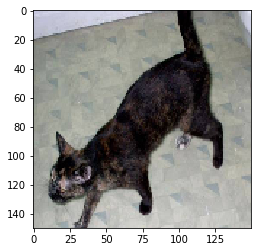

No es Cobi


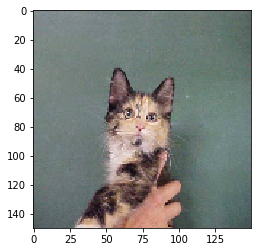

No es Cobi


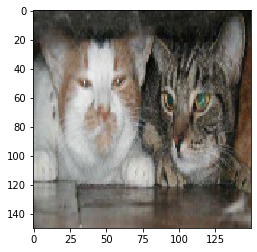

No es Cobi


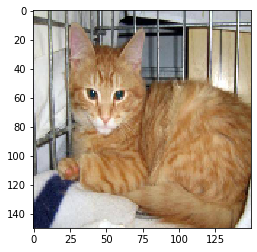

No es Cobi


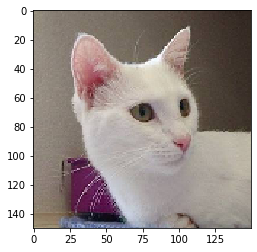

No es Cobi


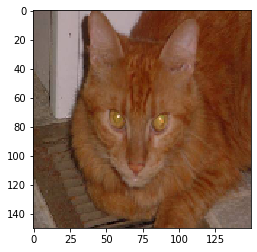

Es Cobi


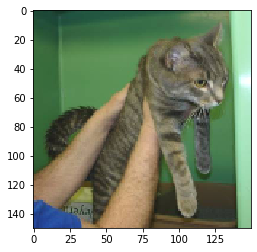

No es Cobi


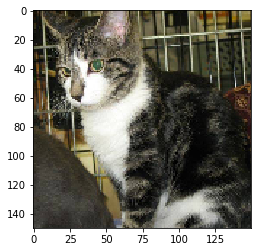

No es Cobi


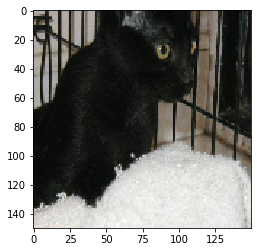

No es Cobi


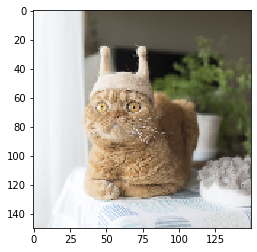

No es Cobi


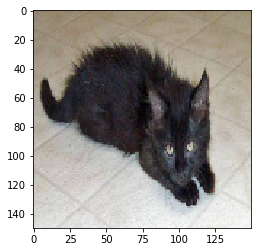

No es Cobi


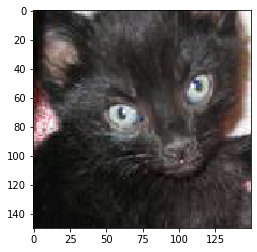

No es Cobi


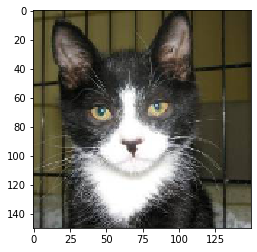

Es Cobi


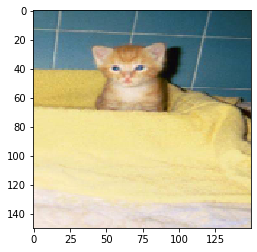

No es Cobi


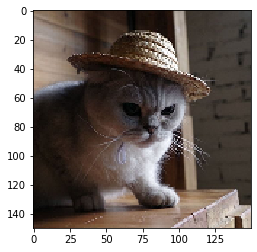

No es Cobi


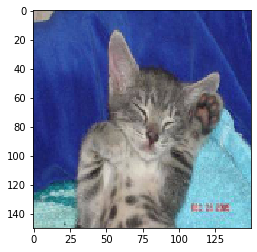

Es Cobi


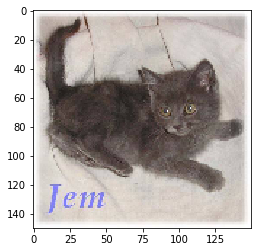

No es Cobi


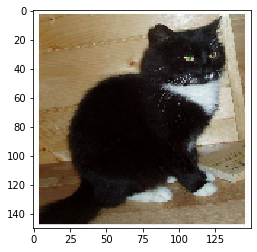

No es Cobi


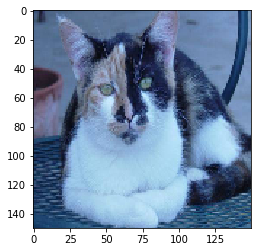

No es Cobi


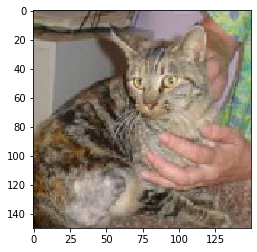

No es Cobi


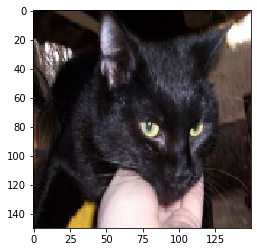

Es Cobi


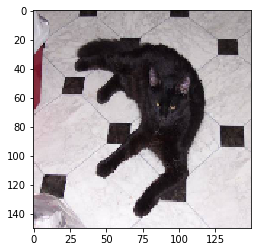

No es Cobi


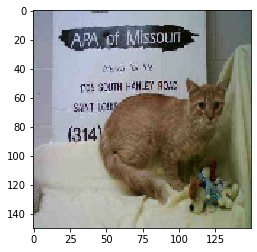

No es Cobi


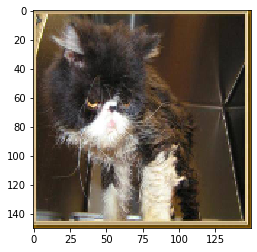

No es Cobi


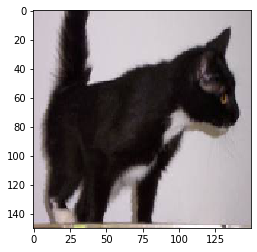

No es Cobi


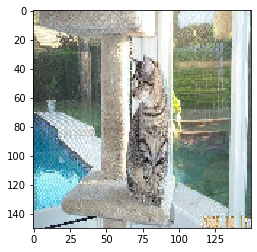

No es Cobi


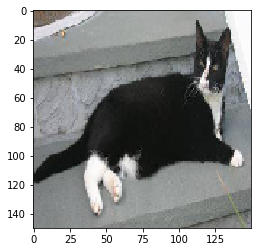

No es Cobi


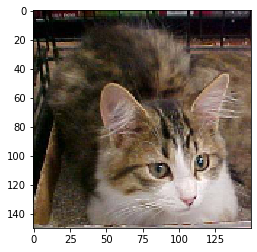

Es Cobi


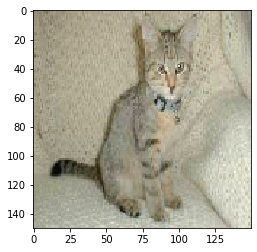

Es Cobi


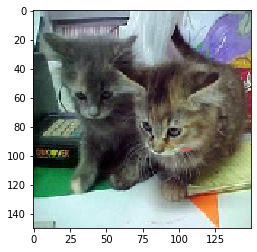

No es Cobi


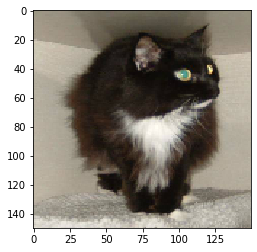

No es Cobi


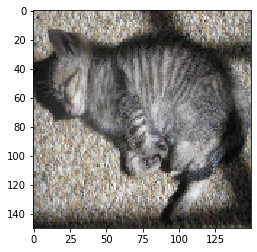

No es Cobi


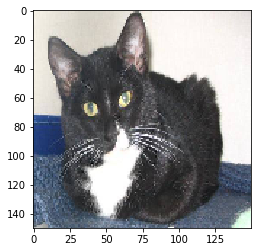

No es Cobi


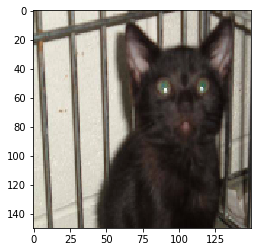

No es Cobi


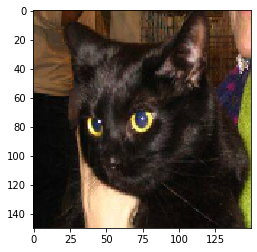

No es Cobi


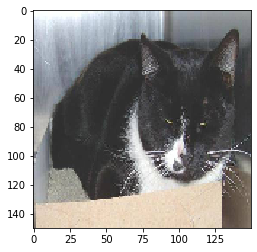

No es Cobi


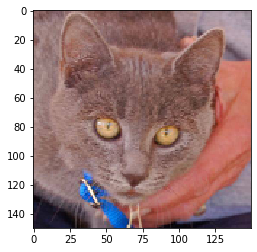

No es Cobi


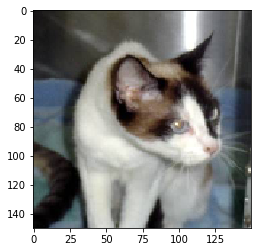

No es Cobi


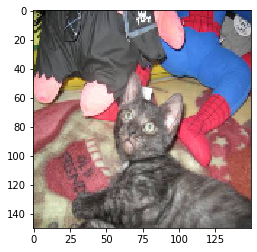

Es Cobi


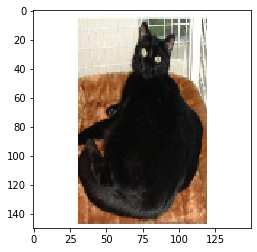

No es Cobi


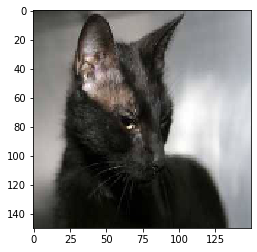

No es Cobi


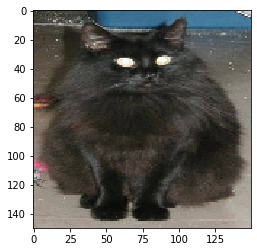

No es Cobi


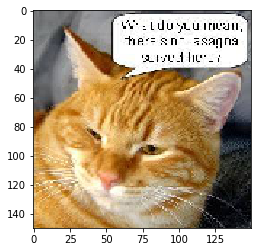

No es Cobi


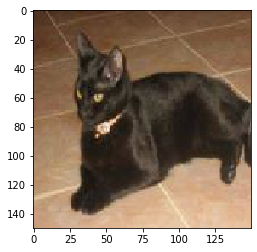

No es Cobi


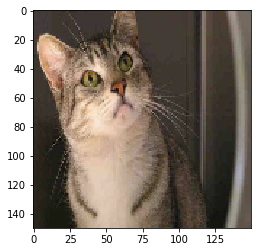

No es Cobi


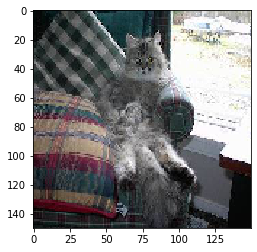

No es Cobi


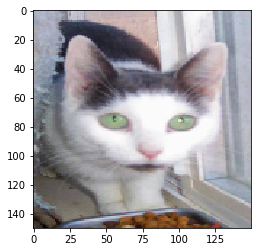

No es Cobi


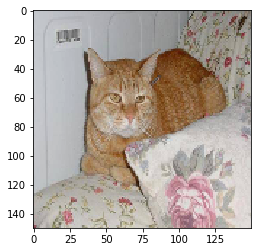

No es Cobi


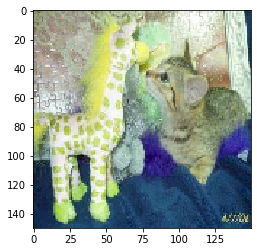

Es Cobi


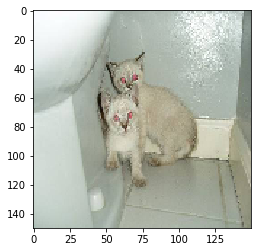

No es Cobi


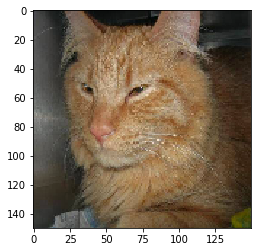

No es Cobi


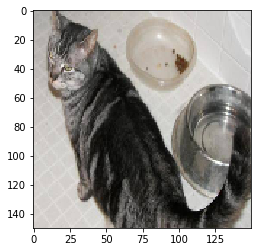

No es Cobi


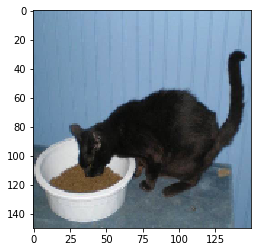

No es Cobi


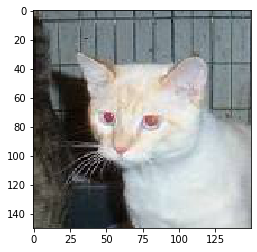

Es Cobi


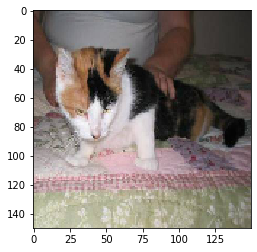

No es Cobi


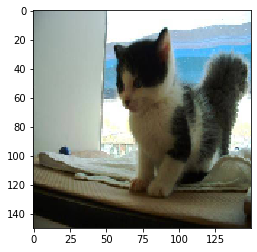

No es Cobi


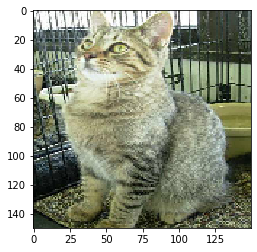

No es Cobi


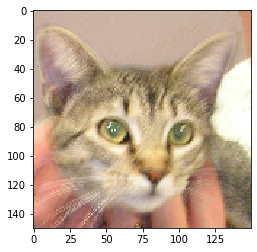

No es Cobi


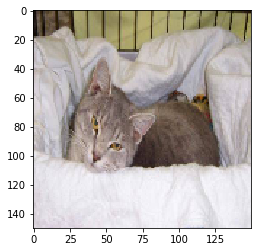

No es Cobi


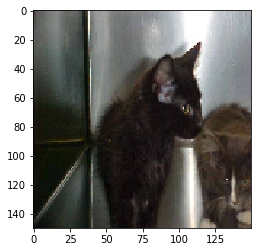

No es Cobi


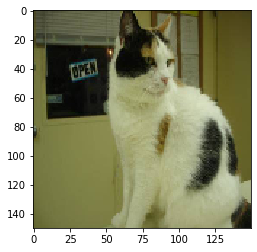

No es Cobi


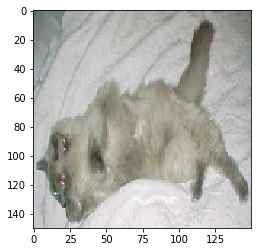

No es Cobi


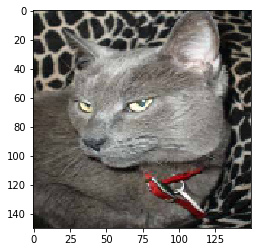

No es Cobi


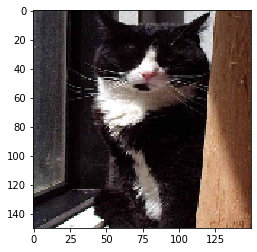

No es Cobi


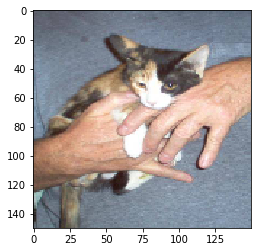

No es Cobi


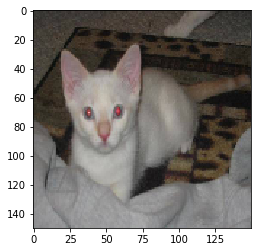

No es Cobi


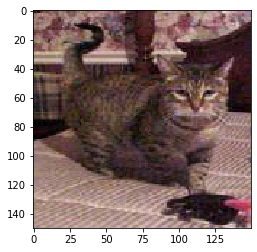

No es Cobi


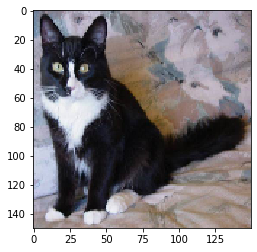

No es Cobi


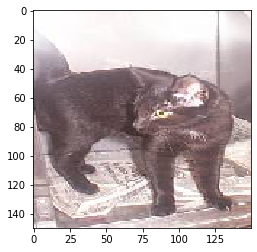

No es Cobi


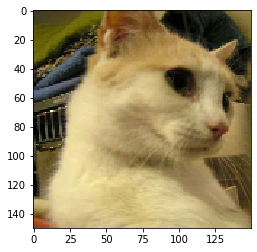

No es Cobi


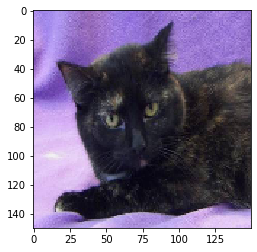

No es Cobi


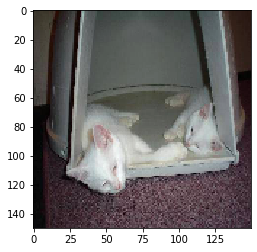

No es Cobi


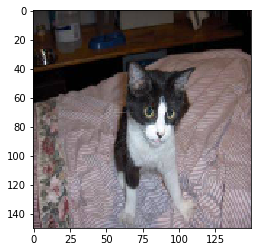

Es Cobi


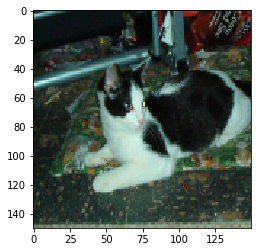

No es Cobi


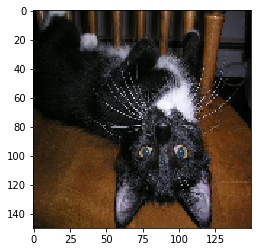

No es Cobi


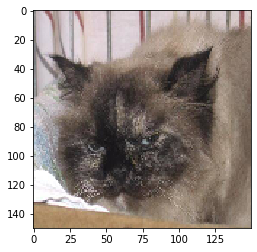

No es Cobi


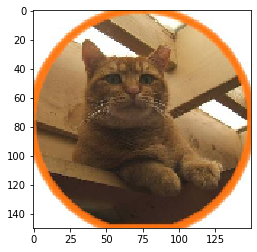

No es Cobi


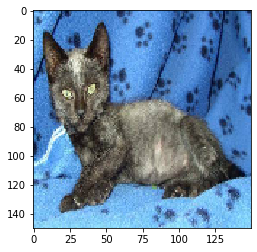

No es Cobi


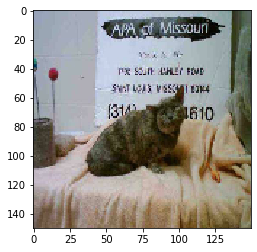

Es Cobi


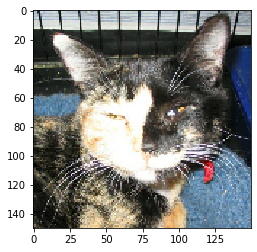

No es Cobi


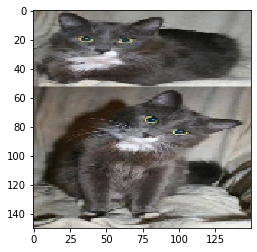

No es Cobi


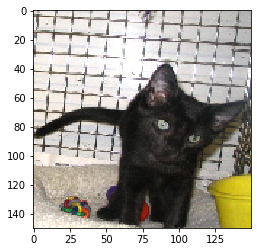

No es Cobi


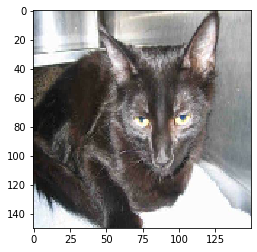

No es Cobi


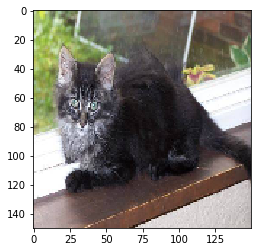

No es Cobi


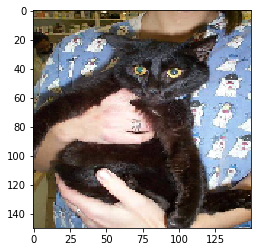

No es Cobi


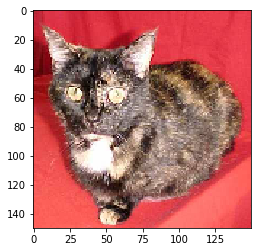

No es Cobi


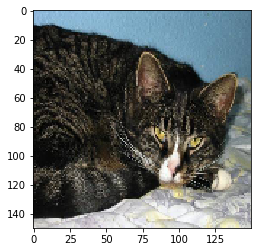

No es Cobi


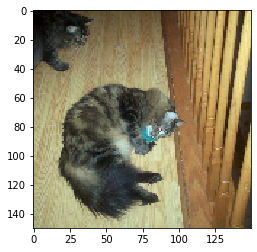

No es Cobi


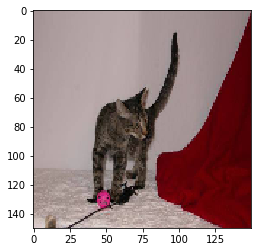

No es Cobi


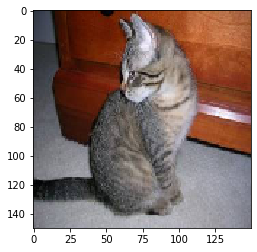

No es Cobi


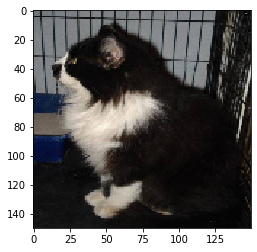

No es Cobi


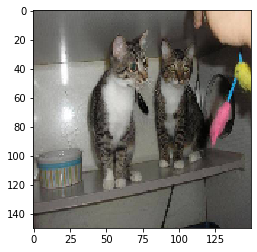

No es Cobi


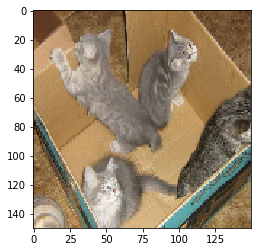

No es Cobi


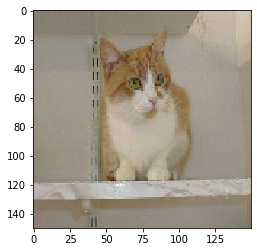

No es Cobi


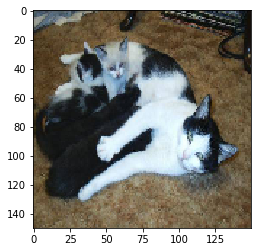

No es Cobi


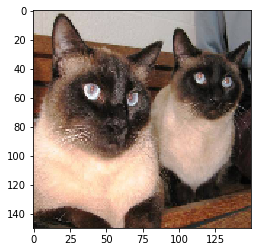

No es Cobi


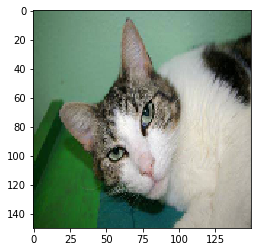

No es Cobi


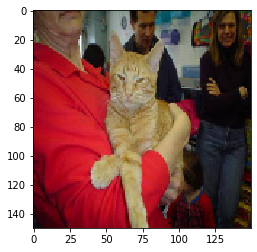

Es Cobi


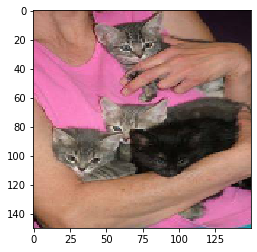

Es Cobi


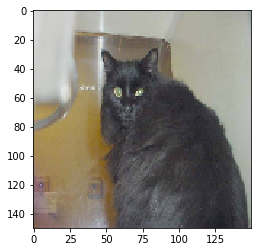

No es Cobi


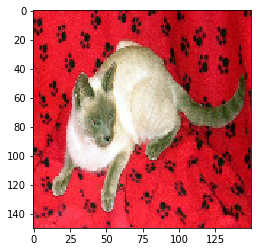

Es Cobi


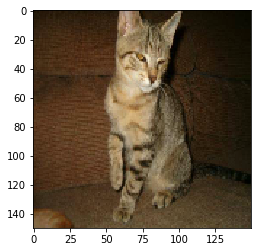

Es Cobi


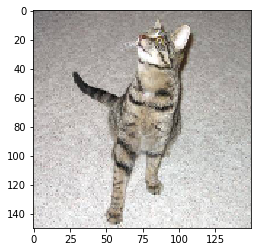

No es Cobi


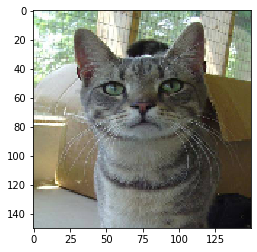

No es Cobi


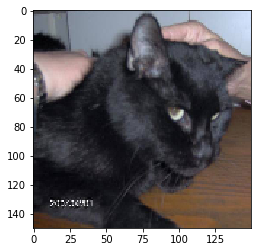

No es Cobi


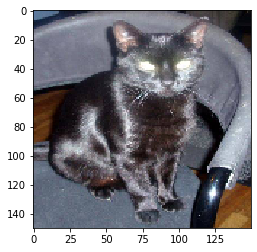

No es Cobi


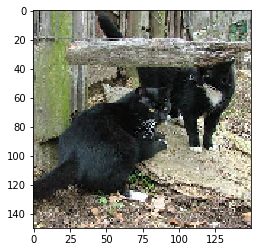

No es Cobi


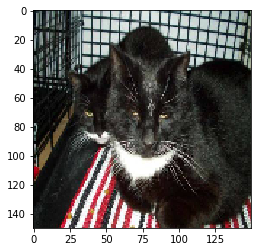

No es Cobi


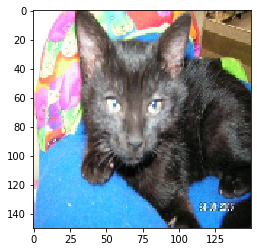

No es Cobi


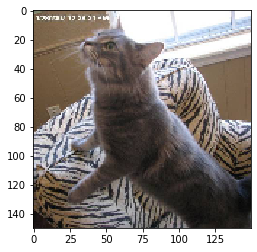

No es Cobi


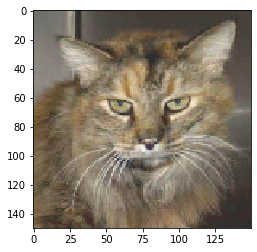

No es Cobi


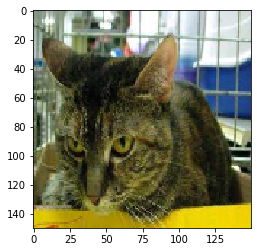

Es Cobi


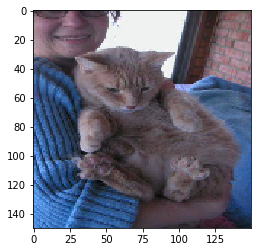

No es Cobi


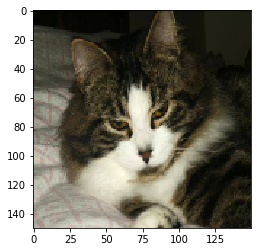

No es Cobi


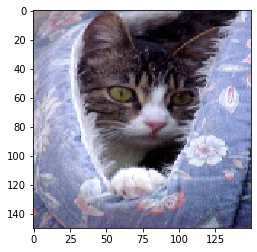

No es Cobi


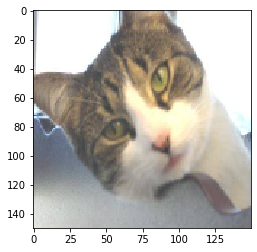

No es Cobi


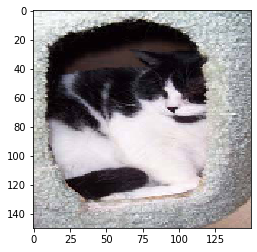

No es Cobi


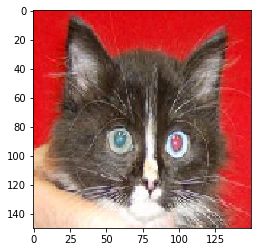

No es Cobi


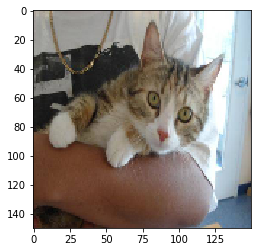

Es Cobi


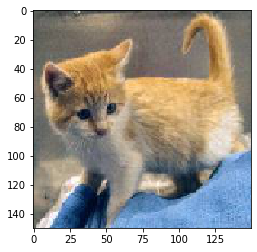

No es Cobi


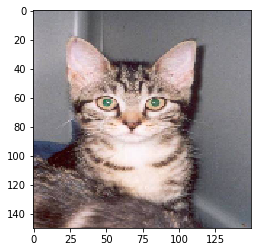

No es Cobi


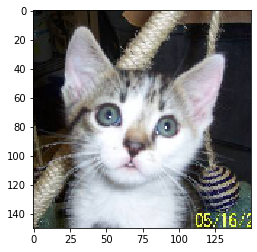

No es Cobi


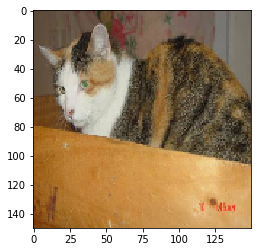

Es Cobi


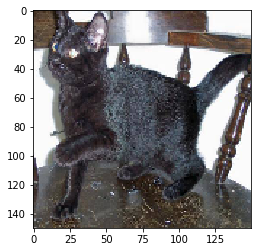

No es Cobi


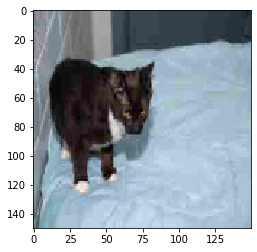

No es Cobi


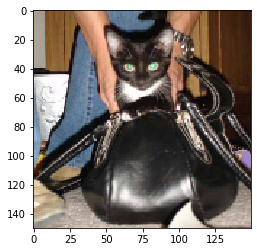

No es Cobi
[[4.4703484e-07]
 [6.5565109e-07]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [9.9966282e-01]
 [0.0000000e+00]
 [1.0000000e+00]
 [9.9975407e-01]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [4.2358041e-04]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.6093254e-06]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0

In [8]:
img1 = load_img('prueba_Cobi1.jpeg', target_size=(150, 150))
img2 = load_img('prueba_Cobi2.jpeg', target_size=(150, 150))
img5 = load_img('prueba_Cobi3.jpeg', target_size=(150, 150))

img3 = load_img('prueba_Gato1.jpg', target_size=(150, 150))
img4 = load_img('prueba_Gato2.jpg', target_size=(150, 150))

F = []
F.append(img1)
F.append(img2)
F.append(img3)
F.append(img4)
F.append(img5)

Z = []
Z.append(img_to_array(img1))
Z.append(img_to_array(img2))
Z.append(img_to_array(img3))
Z.append(img_to_array(img4))
Z.append(img_to_array(img5))
Z = np.array(Z)

Z_pred_proba = model.predict(X_ts)
Z_pred = np.round(Z_pred_proba)
aux = 0
for i in Z_pred:
    imgplot = plt.imshow(array_to_img(X_ts[aux]))
    plt.show()
    aux += 1
    if(i == 0):
        print("Es Cobi")
    else:
        print("No es Cobi")
    
print(Z_pred_proba)
print('')
print(classification_report(Y_ts, Z_pred))
